## Detecting aircraft on Airbus Pleiades imagery with YOLOv5

Recently Airbus Intelligence has published a few Machine Learning Datasets on the Kaggle platform. 

These datasets are samples from much larger and more comprehensive datasets provided by Airbus. 
Nevertheless, they are good datasets to start with and build upon if you wish to learn more about Earth Observation imagery and Deep Learning.

**NOTE: this notebook has been updated on 2023-01-31 to use the latest version of YOLOv5.**

### Libraries imports
First some standard imports.

In [1]:
import os
import ast
import shutil as sh
from pathlib import Path
import random

import numpy as np
import pandas as pd

import PIL

import torch

from tqdm.auto import tqdm

from IPython.display import Image, clear_output

import matplotlib.pyplot as plt
%matplotlib inline

### Installing YOLOv5 locally
Then we just clone the [YOLOv5](https://github.com/ultralytics/yolov5) repository from Ultralytics. Please visit these links for more information.

In [2]:
'''These commands are completed; don't need to rerun'''

# !git clone https://github.com/ultralytics/yolov5
# !pip install -qr yolov5/requirements.txt

Cloning into 'yolov5'...


### Display one random image
The dataset contains 103 images for train and 6 extra images for evaluation (no annotations provided). 
Let's display one image randomly.

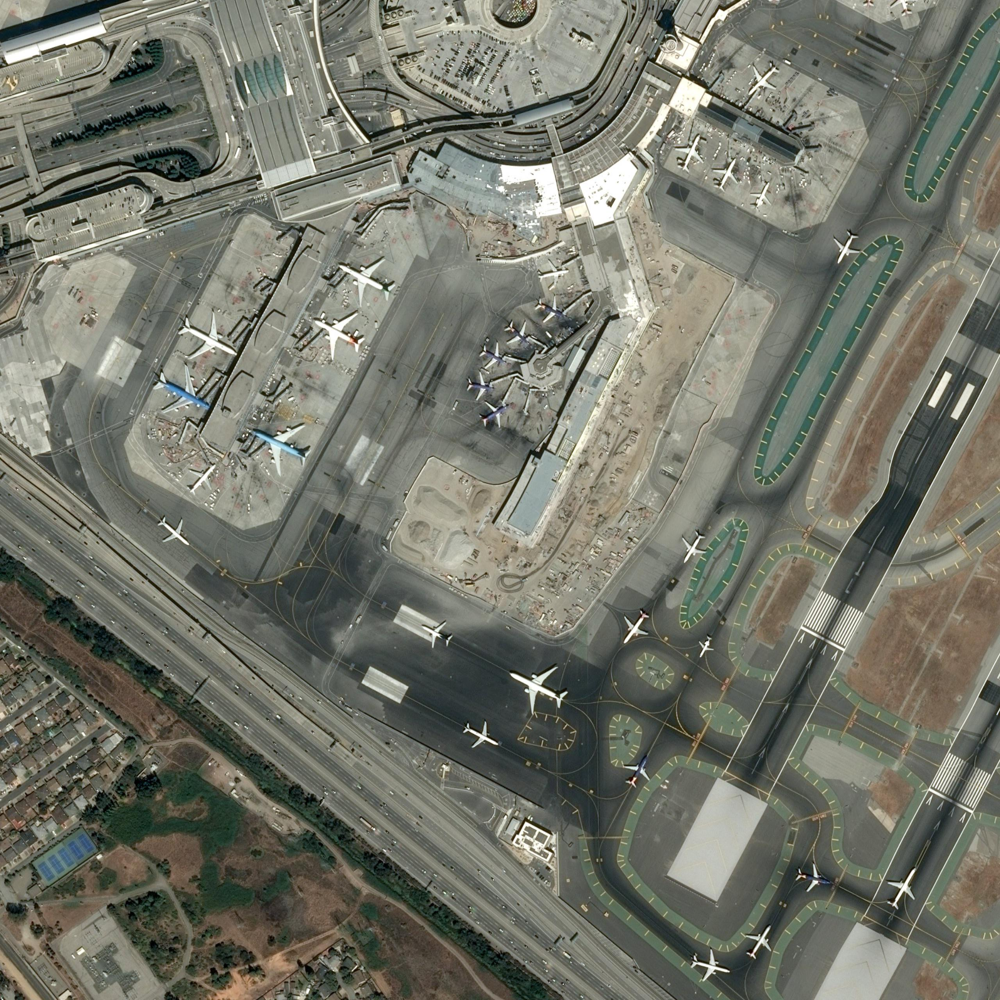

In [3]:
# DATA_DIR = Path('../input/airbus-aircrafts-sample-dataset')
DATA_DIR = Path('..\planes_premade\data')
img_list = list(DATA_DIR.glob('images/*.jpg'))
pickone = random.choice(img_list)
img = PIL.Image.open(pickone)
display(img)

In [4]:
only_files = [DATA_DIR / f.name for f in img_list if os.path.isfile(f) and f.name[-4:] == ".jpg"]
print("Found {} images files in {}".format(len(only_files), DATA_DIR))

IMAGE_HEIGHT, IMAGE_WIDTH = img.size
num_channels = len(img.mode)
print("Image size: {}".format((IMAGE_HEIGHT, IMAGE_WIDTH)))
print("Num channels: {}".format(num_channels))

Found 103 images files in ..\planes_premade\data
Image size: (2560, 2560)
Num channels: 3


The images are actually 2560 pixels by 2560 pixels images in RGB (3 bands) in JPEG format. They are extracted from the Pleiades archive and provided at a resolution of 50 cm per pixel. They come from various locations all over the Earth. Some airports are captured more than one to provide diversity in the location of aircraft, the acquisition angles, and the weather conditions.

### Annotations
The annotations are provided as a CSV file with reference the image, geometry as a closed polygon, and class. 

In [5]:
# convert a string record into a valid python object
def f(x): 
    return ast.literal_eval(x.rstrip('\r\n'))

df = pd.read_csv(DATA_DIR / "annotations.csv", 
                converters={'geometry': f, 'class': lambda o: 'Aircraft'})
df.head(10)

,id,image_id,geometry,class
0,1,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(135, 522), (245, 522), (245, 600), (135, 600...",Aircraft
1,2,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1025, 284), (1125, 284), (1125, 384), (1025,...",Aircraft
2,3,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1058, 1503), (1130, 1503), (1130, 1568), (10...",Aircraft
3,4,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(813, 1518), (885, 1518), (885, 1604), (813, ...",Aircraft
4,5,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(594, 938), (657, 938), (657, 1012), (594, 10...",Aircraft
5,6,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(451, 725), (524, 725), (524, 798), (451, 798...",Aircraft
6,7,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1543, 1437), (1614, 1437), (1614, 1497), (15...",Aircraft
7,8,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1485, 1370), (1561, 1370), (1561, 1437), (14...",Aircraft
8,9,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1968, 1624), (2053, 1624), (2053, 1687), (19...",Aircraft
9,10,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1659, 1674), (1733, 1674), (1733, 1746), (16...",Aircraft


There are 3,425 annotations for aircraft including aircraft truncated at the border of the imagery.
Let's parse the geometries to compute some useful metrics.

In [6]:
def getBounds(geometry):
    try: 
        arr = np.array(geometry).T
        xmin = np.min(arr[0])
        ymin = np.min(arr[1])
        xmax = np.max(arr[0])
        ymax = np.max(arr[1])
        return (xmin, ymin, xmax, ymax)
    except:
        return np.nan

def getWidth(bounds):
    try: 
        (xmin, ymin, xmax, ymax) = bounds
        return np.abs(xmax - xmin)
    except:
        return np.nan

def getHeight(bounds):
    try: 
        (xmin, ymin, xmax, ymax) = bounds
        return np.abs(ymax - ymin)
    except:
        return np.nan

# Create bounds, width and height
df.loc[:,'bounds'] = df.loc[:,'geometry'].apply(getBounds)
df.loc[:,'width'] = df.loc[:,'bounds'].apply(getWidth)
df.loc[:,'height'] = df.loc[:,'bounds'].apply(getHeight)
df.head(10)

,id,image_id,geometry,class,bounds,width,height
0,1,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(135, 522), (245, 522), (245, 600), (135, 600...",Aircraft,"(135, 522, 245, 600)",110,78
1,2,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1025, 284), (1125, 284), (1125, 384), (1025,...",Aircraft,"(1025, 284, 1125, 384)",100,100
2,3,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1058, 1503), (1130, 1503), (1130, 1568), (10...",Aircraft,"(1058, 1503, 1130, 1568)",72,65
3,4,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(813, 1518), (885, 1518), (885, 1604), (813, ...",Aircraft,"(813, 1518, 885, 1604)",72,86
4,5,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(594, 938), (657, 938), (657, 1012), (594, 10...",Aircraft,"(594, 938, 657, 1012)",63,74
5,6,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(451, 725), (524, 725), (524, 798), (451, 798...",Aircraft,"(451, 725, 524, 798)",73,73
6,7,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1543, 1437), (1614, 1437), (1614, 1497), (15...",Aircraft,"(1543, 1437, 1614, 1497)",71,60
7,8,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1485, 1370), (1561, 1370), (1561, 1437), (14...",Aircraft,"(1485, 1370, 1561, 1437)",76,67
8,9,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1968, 1624), (2053, 1624), (2053, 1687), (19...",Aircraft,"(1968, 1624, 2053, 1687)",85,63
9,10,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1659, 1674), (1733, 1674), (1733, 1746), (16...",Aircraft,"(1659, 1674, 1733, 1746)",74,72


### Validation split
Here, we perform the usual train/valid split in order to control the learning process with a small sample of images which will not be part of the learning batches. 
**BEWARE, do not perform the split on the tiles but on the source images. The tiling is done according to the split between training and validation. The tiles from the same image should fall in the same group. Otherwise, you will have data leakage between the train and validation and your validation set will be quite useless.**

In [38]:
# create a list of images used for validation
fold = 1
num_fold = 5
index = df['image_id'].unique()
# val_indexes = index[len(index)*fold//num_fold:len(index)*(fold+1)//num_fold]
# print(val_indexes)

val_indexes = index[0:len(index)*2//3] # Increase validation -> dec training -> speedup (25% train)
print(val_indexes[0:5])
print("total val: {}".format(len(val_indexes)))

['4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg'
 '74d335db-bf64-424a-88d7-5c24625c50b1.jpg'
 '4e8c95f3-bbb6-4e2f-920d-8d3b2bd1d29f.jpg'
 '72fa2a77-cf8e-44a2-9ab2-f11ca63b4b72.jpg'
 '2314c1b5-ec8f-4212-b42f-43365a13fd20.jpg']
total val: 68


### Tiling
The images are too big for YOLO to learn correctly. We need to make smaller images (or tiles). There are multiple options to do this. Here, we generate the tiles in advance with a selected size of 512 pixels by 512 pixels. In order to make sure that every aircraft can be seen by the network in full, we allow for an overlap of 64 pixels between the tiles. And we generate the tiles in the folder /kaggle/working. 

In [39]:
import os 
import tqdm.notebook

# Create 512x512 tiles with 64 pix overlap in /kaggle/working
TILE_WIDTH = 512
TILE_HEIGHT = 512
TILE_OVERLAP = 64
TRUNCATED_PERCENT = 0.3
_overwriteFiles = True

# TILES_DIR = {'train': Path('/kaggle/working/train/images/'),
#              'val': Path('/kaggle/working/val/images/')}

TILES_DIR = {'train': Path('..\planes_premade\kaggle\working\\train\images'),
             'val': Path('..\planes_premade\kaggle\working\\val\images')}

for _, folder in TILES_DIR.items():
    if not os.path.isdir(folder):
        os.makedirs(folder)

# LABELS_DIR = {'train': Path('/kaggle/working/train/labels/'),
#               'val': Path('/kaggle/working/val/labels/')}

LABELS_DIR = {'train': Path('..\planes_premade\kaggle\working\\train\labels'),
              'val': Path('..\planes_premade\kaggle\working\\val\labels')}

for _, folder in LABELS_DIR.items():
    if not os.path.isdir(folder):
        os.makedirs(folder)

# Save one line in .txt file for each tag found inside the tile
def tag_is_inside_tile(bounds, x_start, y_start, width, height, truncated_percent):
    x_min, y_min, x_max, y_max = bounds
    x_min, y_min, x_max, y_max = x_min - x_start, y_min - y_start, x_max - x_start, y_max - y_start

    if (x_min > width) or (x_max < 0.0) or (y_min > height) or (y_max < 0.0):
        return None
    
    x_max_trunc = min(x_max, width) 
    x_min_trunc = max(x_min, 0) 
    if (x_max_trunc - x_min_trunc) / (x_max - x_min) < truncated_percent:
        return None

    y_max_trunc = min(y_max, width) 
    y_min_trunc = max(y_min, 0) 
    if (y_max_trunc - y_min_trunc) / (y_max - y_min) < truncated_percent:
        return None
        
    x_center = (x_min_trunc + x_max_trunc) / 2.0 / width
    y_center = (y_min_trunc + y_max_trunc) / 2.0 / height
    x_extend = (x_max_trunc - x_min_trunc) / width
    y_extend = (y_max_trunc - y_min_trunc) / height
    
    return (0, x_center, y_center, x_extend, y_extend)
            
for img_path in tqdm.notebook.tqdm(img_list):
    # Open image and related data
    pil_img = PIL.Image.open(img_path, mode='r')
    np_img = np.array(pil_img, dtype=np.uint8)

    # Get annotations for image
    img_labels = df[df["image_id"] == img_path.name]
    #print(img_labels)

    # Count number of sections to make
    X_TILES = (IMAGE_WIDTH + TILE_WIDTH - TILE_OVERLAP - 1) // (TILE_WIDTH - TILE_OVERLAP)
    Y_TILES = (IMAGE_HEIGHT + TILE_HEIGHT - TILE_OVERLAP - 1) // (TILE_HEIGHT - TILE_OVERLAP)
    
    # Cut each tile
    for x in range(X_TILES):
        for y in range(Y_TILES):

            x_end = min((x + 1) * TILE_WIDTH - TILE_OVERLAP * (x != 0), IMAGE_WIDTH)
            x_start = x_end - TILE_WIDTH
            y_end = min((y + 1) * TILE_HEIGHT - TILE_OVERLAP * (y != 0), IMAGE_HEIGHT)
            y_start = y_end - TILE_HEIGHT
            #print(x_start, y_start)

            folder = 'val' if img_path.name in val_indexes else 'train'
            save_tile_path = TILES_DIR[folder].joinpath(img_path.stem + "_" + str(x_start) + "_" + str(y_start) + ".jpg")
            save_label_path = LABELS_DIR[folder].joinpath(img_path.stem + "_" + str(x_start) + "_" + str(y_start) + ".txt")
                
            # Save if file doesn't exit
            if _overwriteFiles or not os.path.isfile(save_tile_path):
                cut_tile = np.zeros(shape=(TILE_WIDTH, TILE_HEIGHT, 3), dtype=np.uint8)
                cut_tile[0:TILE_HEIGHT, 0:TILE_WIDTH, :] = np_img[y_start:y_end, x_start:x_end, :]
                cut_tile_img = PIL.Image.fromarray(cut_tile)
                cut_tile_img.save(save_tile_path)

            found_tags = [
                tag_is_inside_tile(bounds, x_start, y_start, TILE_WIDTH, TILE_HEIGHT, TRUNCATED_PERCENT)
                for i, bounds in enumerate(img_labels['bounds'])]
            found_tags = [el for el in found_tags if el is not None]

            # save labels
            with open(save_label_path, 'w+') as f:
                for tags in found_tags:
                    f.write(' '.join(str(x) for x in tags) + '\n')

  0%|          | 0/103 [00:00<?, ?it/s]

In [40]:
# CONFIG = """
# # train and val datasets (image directory or *.txt file with image paths)
# train: /kaggle/working/train/
# val: /kaggle/working/val/

# # number of classes
# nc: 1

# # class names
# names: ['Aircraft']
# """

CONFIG = """
# train and val datasets (image directory or *.txt file with image paths)
train: ..\kaggle\working\\train
val: ..\kaggle\working\\val/

# number of classes
nc: 1

# class names
names: ['Aircraft']
"""

with open("dataset.yaml", "w") as f:
    f.write(CONFIG)

In [41]:
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Setup complete. Using torch 2.2.0+cpu CPU


### Logging
Tensorboard is not available on Kaggle anymore. YOLOv5 provides native integration with **Weights and Biases**
For now, we will only use the standard local logging provided by YOLOv5. for this, we need to remove the wandb package.

In [ ]:
# Weigths and Biaises (optional)
#import wandb
#wandb.login()

In [ ]:
# Remove Weigths and Biaises if not used.
# !pip uninstall -y wandb

### Training
First, we clean logs from previous runs and launch the training for 10 epochs using pre-trained weights on the COCO dataset.

In [ ]:
# remove previous runs so that following cells works with 'exp' folder

# Need to do this manually
# ..\..\planes_kaggle\working\\runs
!rm -rf /kaggle/working/runs

In [11]:
# Test output to file - works!
# ! dir > "test.txt"

In [42]:
# !python /kaggle/working/yolov5/train.py --cfg yolov5s.yaml --imgsz 512 --batch-size 16 --epochs 10 --data /kaggle/working/dataset.yaml --weights yolov5s.pt
# !python ../planes_premade/yolov5/train.py --cfg yolov5s.yaml --imgsz 512 --batch-size 32 --epochs 2 --data dataset.yaml --weights yolov5s.pt

train: weights=yolov5s.pt, cfg=yolov5s.yaml, data=dataset.yaml, hyp=yolov5\data\hyps\hyp.scratch-low.yaml, epochs=2, batch_size=32, imgsz=512, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=yolov5\data\hyps, resume_evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=yolov5\runs\train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest, ndjson_console=False, ndjson_file=False
github: up to date with https://github.com/ultralytics/yolov5 
YOLOv5  v7.0-294-gdb125a20 Python-3.9.7 torch-2.2.0+cpu CPU

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, o


So, after a few epochs and no specific tuning, we already get an recall of 86% meaning that 14 aircraft out of one hundred are missed. And we get a precision of 96% which indicates that out of one hundred detected aircraft only 4 are actually not aircraft (i.e. false alarms). Of course, this can be improved but seems pretty good already. 


## Logs
During training, we can access the log folder to get insights on how our model is learning.

In [43]:
# check files provided in log folder
# !ls yolov5/runs/train/exp
! dir "yolov5\\runs\\train\exp"

 Volume in drive C is Local Disk
 Volume Serial Number is 9CA7-0D6F

 Directory of c:\Users\jamen\Capstone_II\planes_premade\yolov5\runs\train\exp

2024-03-13  11:58 AM    <DIR>          .
2024-03-13  11:58 AM    <DIR>          ..
2024-03-13  11:58 AM            84,989 confusion_matrix.png
2024-03-13  11:59 AM           932,613 events.out.tfevents.1710347819.DESKTOP-Jamen.17728.0
2024-03-13  11:58 AM            87,861 F1_curve.png
2024-03-13  09:36 AM               401 hyp.yaml
2024-03-13  09:44 AM           193,001 labels.jpg
2024-03-13  09:44 AM           235,412 labels_correlogram.jpg
2024-03-13  09:36 AM             1,259 opt.yaml
2024-03-13  11:58 AM            89,947 PR_curve.png
2024-03-13  11:58 AM           113,131 P_curve.png
2024-03-13  11:35 AM               885 results.csv
2024-03-13  11:58 AM           243,390 results.png
2024-03-13  11:58 AM            92,415 R_curve.png
2024-03-13  09:45 AM           547,451 train_batch0.jpg
2024-03-13  09:46 AM           559,987 train_

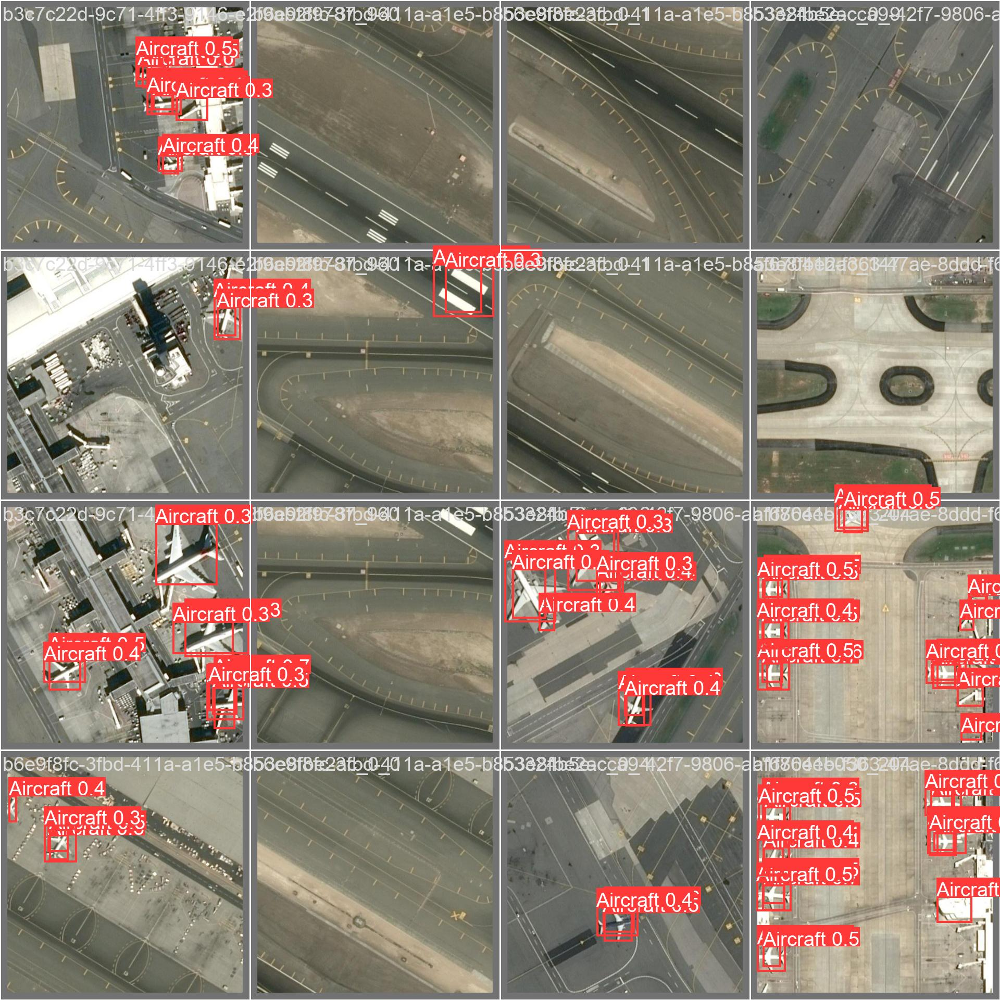

In [44]:
# predictions on batch 1
# Image(filename='/kaggle/working/yolov5/runs/train/exp/val_batch1_pred.jpg', width=800)
Image(filename='yolov5\\runs\\train\exp\\val_batch1_pred.jpg', width=800)

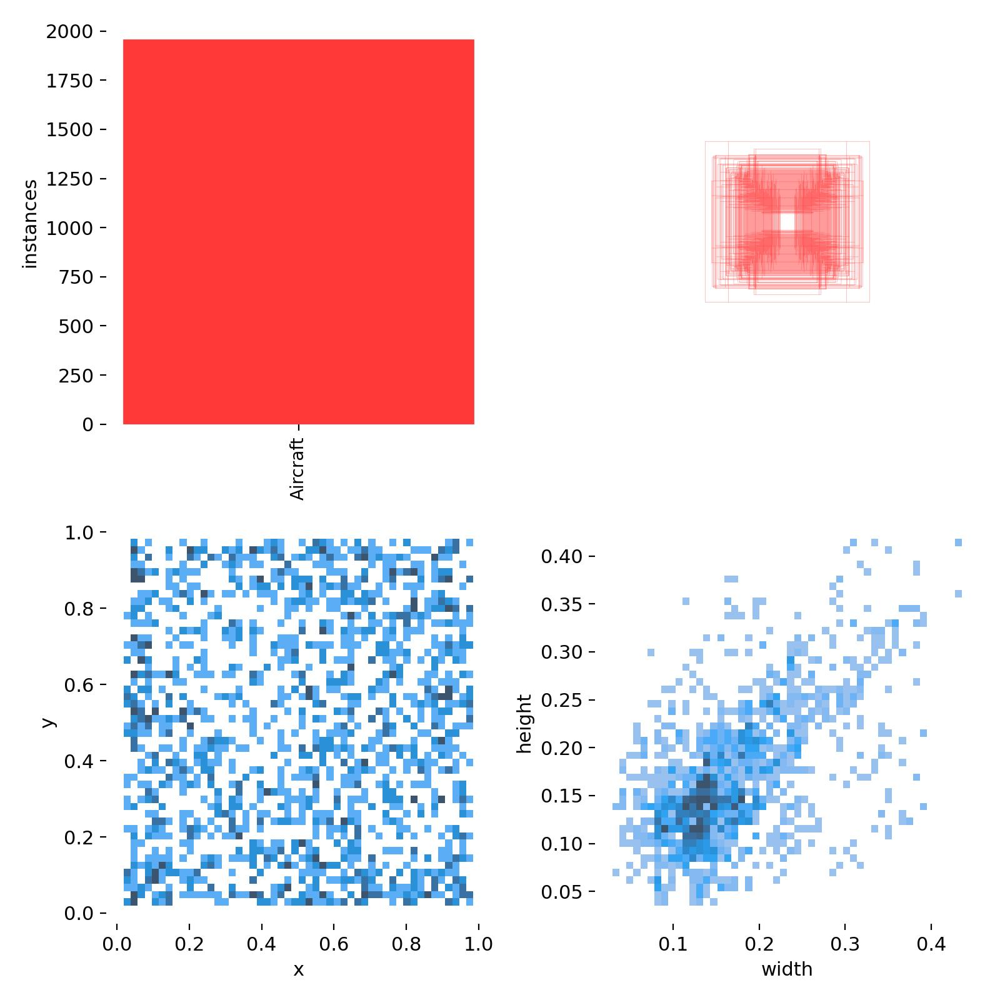

In [46]:
# analysis of labels and boxes
# Image(filename='/kaggle/working/yolov5/runs/train/exp/labels.jpg', width=800)
Image(filename='yolov5\\runs\\train\exp\labels.jpg', width=800)

In [33]:
# we can access all parameters values used for this training
# !cat /kaggle/working/yolov5/runs/train/exp/opt.yaml
!cat "yolov5\\runs\\train\exp3\opt.yaml"

'cat' is not recognized as an internal or external command,
operable program or batch file.


### Predictions
We can run some predictions on the sample imagery and display one random image. 

In [ ]:
# Need to delete manually
!rm -rf /kaggle/working/yolov5/runs/detect/

In [2]:
# !rm -rf /kaggle/working/yolov5/runs/detect/
# !python /kaggle/working/yolov5/detect.py --source ../input/airbus-aircrafts-sample-dataset/extras/ --img-size 2560 --weights /kaggle/working/yolov5/runs/train/exp/weights/best.pt --conf 0.5

# !python yolov5/detect.py --source data/extras --img-size 2560 --weights yolov5/runs/train/exp/weights/best.pt --conf 0.4
!python yolov5/detect.py --source data/extras --img-size 2560 --weights yolov5s_best.pt --conf 0.4

detect: weights=['yolov5s_best.pt'], source=data/extras, data=yolov5\data\coco128.yaml, imgsz=[2560, 2560], conf_thres=0.5, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=yolov5\runs\detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5  v7.0-294-gdb125a20 Python-3.9.7 torch-2.2.0+cpu CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
image 1/6 C:\Users\jamen\Capstone_II\planes_premade_1_good\data\extras\022f91f0-1434-401f-a11b-e315b7068100.jpg: 2560x2560 (no detections), 4945.0ms
image 2/6 C:\Users\jamen\Capstone_II\planes_premade_1_good\data\extras\08a8132a-a6c7-4cab-adee-7e2976fd2822.jpg: 2560x2560 1 airplane, 1 clock, 4625.3ms
image 3/6 C:\Users\jamen\Capstone_II\planes_premade_1_good\dat

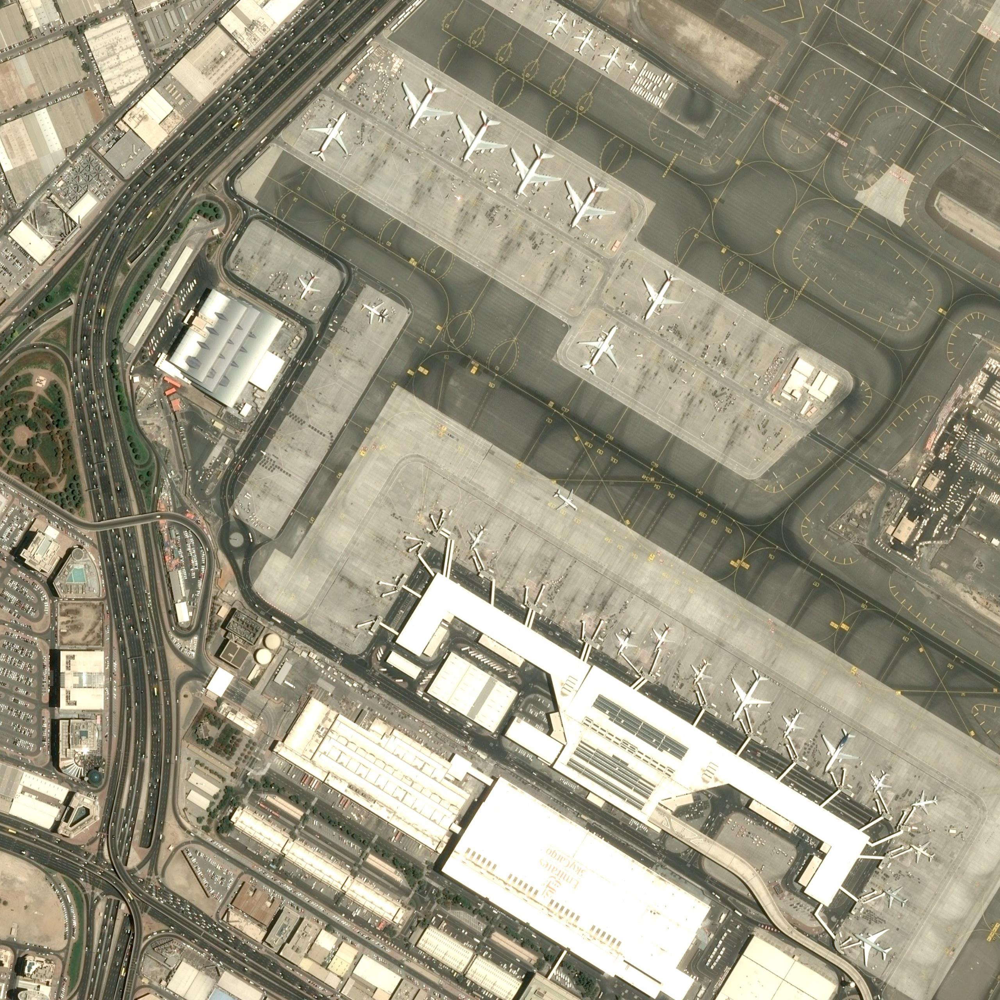

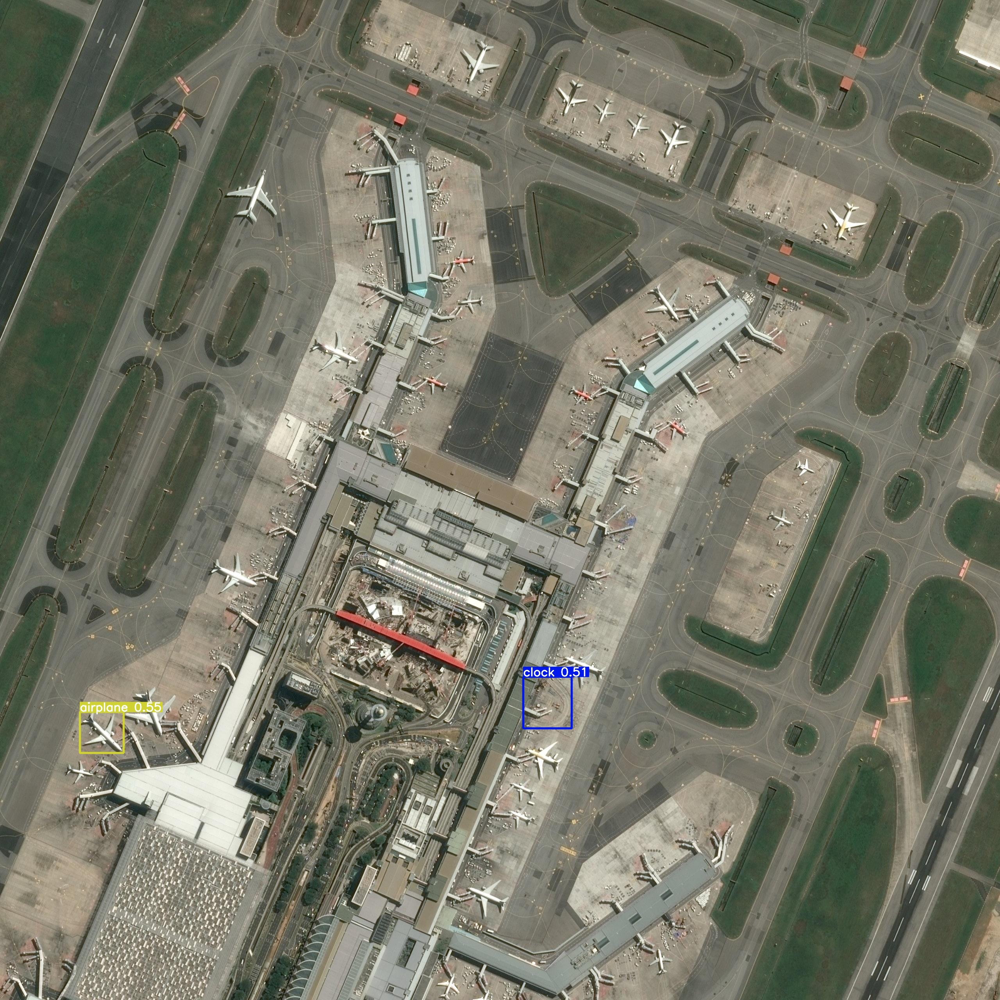

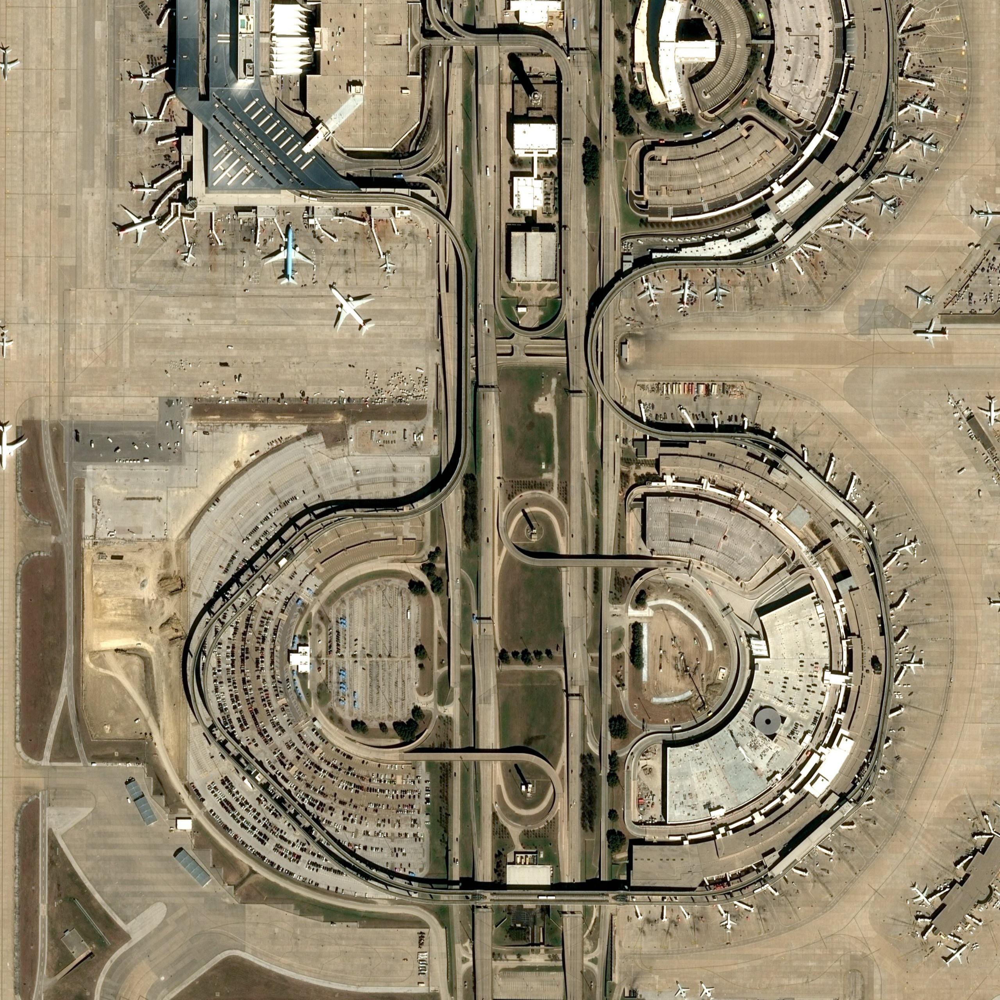

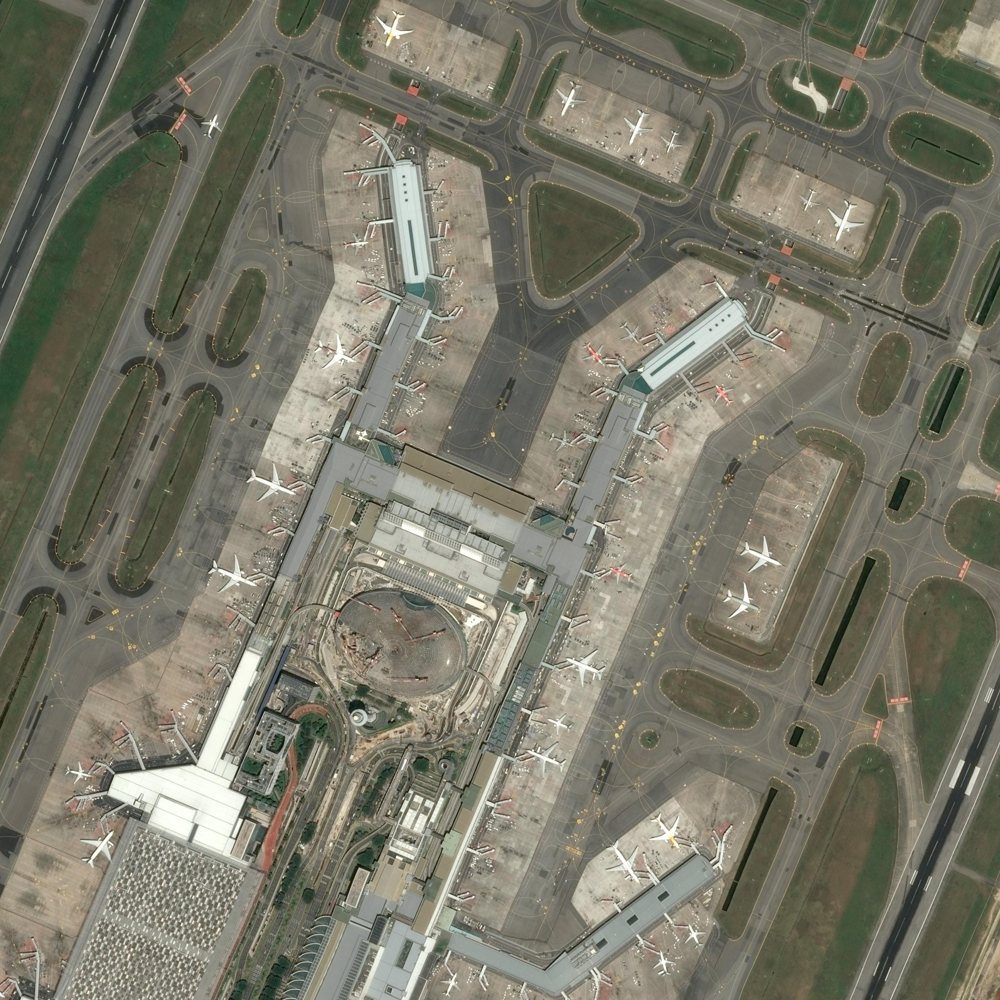

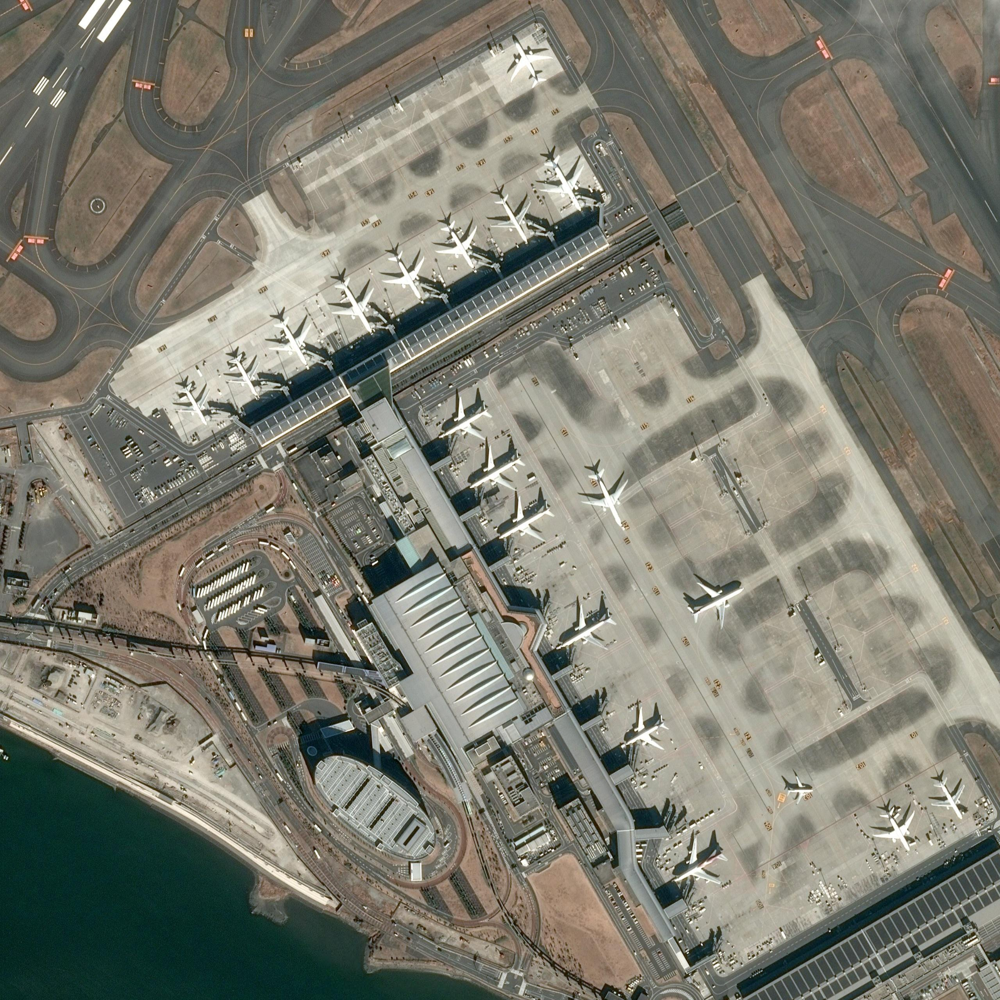

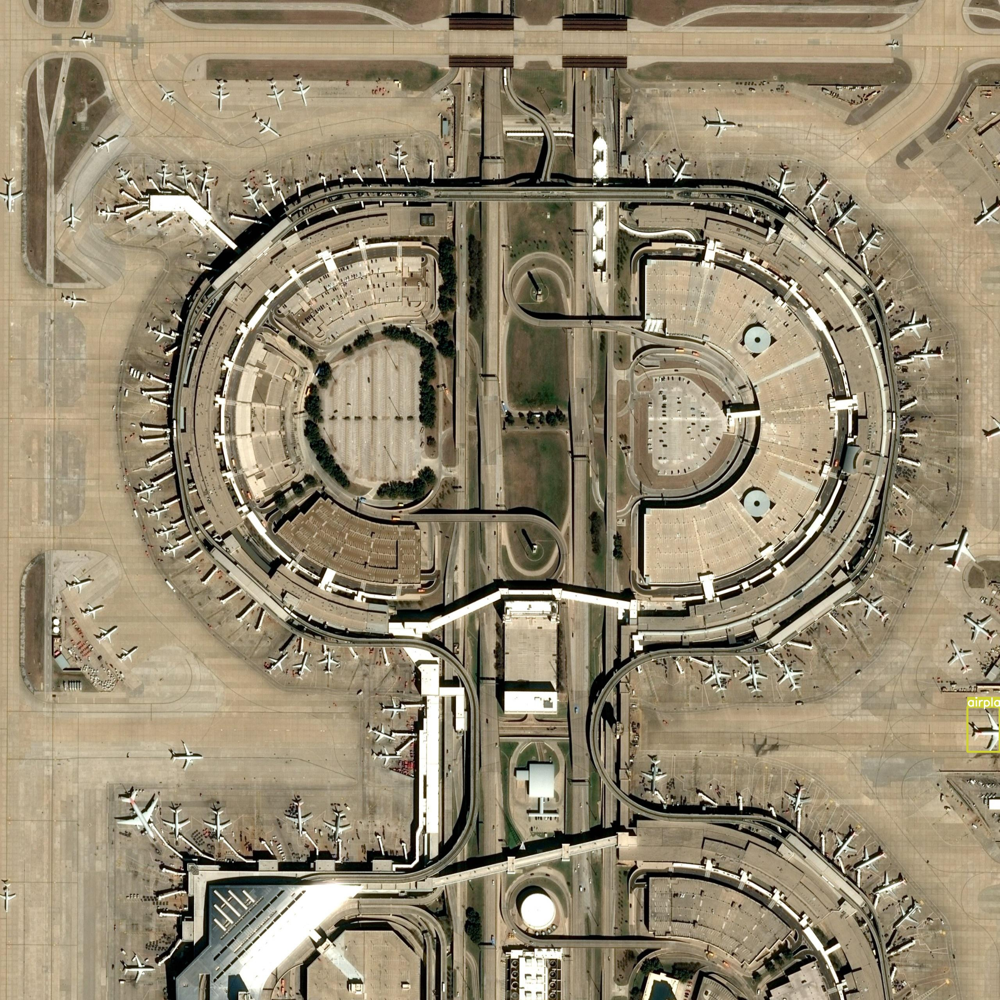

In [3]:
import glob
from IPython.display import Image, display

# for image_path in glob.glob('/kaggle/working/yolov5/runs/detect/exp/*.jpg'):
for image_path in glob.glob('yolov5\\runs\detect\exp4\*.jpg'):
      display(Image(filename=image_path, width=1024))
      print("\n")

### Export model to tensorflow lite
yolov5/export.py has documentation on its useage

In [54]:
!python ../planes_premade/yolov5/export.py --weights yolov5s.pt --include tflite

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(1, 640, 640, 3)]           0         []                            
                                                                                                  
 tf_conv (TFConv)            (1, 320, 320, 32)            3488      ['input_1[0][0]']             
                                                                                                  
 tf_conv_1 (TFConv)          (1, 160, 160, 64)            18496     ['tf_conv[0][0]']             
                                                                                                  
 tfc3 (TFC3)                 (1, 160, 160, 64)            18624     ['tf_conv_1[0][0]']           
                                                                                              

export: data=C:\Users\jamen\Capstone_II\planes_premade\yolov5\data\coco128.yaml, weights=['yolov5s.pt'], imgsz=[640, 640], batch_size=1, device=cpu, half=False, inplace=False, keras=False, optimize=False, int8=False, per_tensor=False, dynamic=False, simplify=False, opset=17, verbose=False, workspace=4, nms=False, agnostic_nms=False, topk_per_class=100, topk_all=100, iou_thres=0.45, conf_thres=0.25, include=['tflite']
YOLOv5  v7.0-294-gdb125a20 Python-3.9.7 torch-2.2.0+cpu CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs

PyTorch: starting from yolov5s.pt with output shape (1, 25200, 85) (14.1 MB)

TensorFlow SavedModel: starting export with tensorflow 2.14.0...
WARNING  using Tensorflow 2.14.0 > 2.13.1 might cause issue when exporting the model to tflite https://github.com/ultralytics/yolov5/issues/12489

                 from  n    params  module                                  arguments                     
  0                -1  1    